## Explore the Data

This notebook assumes the data has been split into a training and a test set. If not, run get_data.ipynb first.

In [9]:
import pandas as pd

TRAINING_FILEPATH = 'data/training_set.csv'
TEST_FILEPATH = 'data/test_set.csv'

training_set = pd.read_csv(TRAINING_FILEPATH, index_col='index')
test_set = pd.read_csv(TEST_FILEPATH, index_col='index')

In [10]:
# copy the training set for exploration
imdb_train = training_set.copy()

In [11]:
# find featuers that correlate with the IMDb rating
imdb_train.corr()['imdbRating'].sort_values(ascending=False)

imdbRating          1.000000
nrOfWins            0.197543
Drama               0.182356
ratingCount         0.158875
nrOfNominations     0.131055
History             0.088031
nrOfUserReviews     0.085104
Animation           0.079621
nrOfPhotos          0.076881
War                 0.073573
nrOfNewsArticles    0.073354
Biography           0.070995
Documentary         0.058263
FilmNoir            0.044466
Mystery             0.031393
Crime               0.031056
Music               0.024214
duration            0.004470
nrOfGenre           0.004088
GameShow            0.002710
Romance            -0.000913
Musical            -0.001162
Western            -0.004177
Sport              -0.008489
TalkShow           -0.008957
Short              -0.018140
Adult              -0.025073
Comedy             -0.028182
Adventure          -0.038659
RealityTV          -0.043909
News               -0.048069
Family             -0.049218
Fantasy            -0.059329
Thriller           -0.071521
Action        

[]

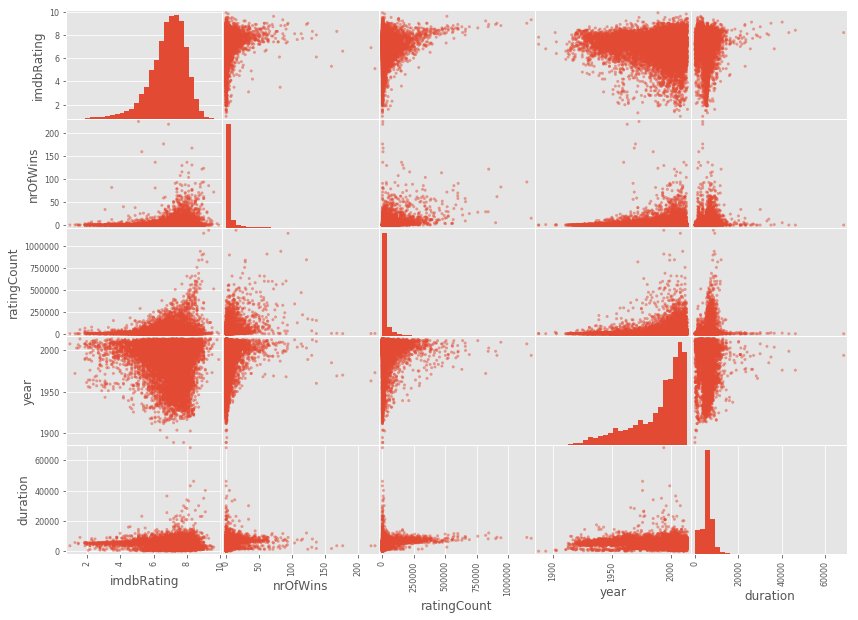

In [12]:
%matplotlib inline
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix

# visualize some correlations
features = ['imdbRating', 'nrOfWins', 'ratingCount', 'year', 'duration']

plt.style.use('ggplot')
scatter_matrix(imdb_train[features], figsize=(14, 10), hist_kwds={'bins': 30})
plt.plot()

In [13]:
# add some feature combinations
imdb_train['totalNominations'] = imdb_train['nrOfNominations'] + imdb_train['nrOfWins']
imdb_train['winsPerNomination'] = imdb_train['nrOfWins'] / imdb_train['totalNominations']
imdb_train['winsPerNomination'].fillna(0, inplace=True)
imdb_train['reviewsPerRating'] = imdb_train['nrOfUserReviews'] / imdb_train['ratingCount']
imdb_train['reviewsPerRating'].fillna(0, inplace=True)

In [14]:
# add titleWordCount feature, does title length affect rating?
def count(s):
    return len(s.split())

imdb_train['titleWordCount'] = imdb_train['wordsInTitle'].map(count, na_action='ignore')

In [15]:
imdb_train[['winsPerNomination', 'reviewsPerRating', 'totalNominations', 'titleWordCount']].describe()

,winsPerNomination,reviewsPerRating,totalNominations,titleWordCount
count,10840.000000,10840.000000,10840.000000,10830.000000
mean,0.237001,0.011991,8.344373,4.213758
std,0.319922,0.018376,25.767147,2.504666
min,0.000000,0.000000,0.000000,1.000000
25%,0.000000,0.003230,0.000000,2.000000
50%,0.000000,0.006675,0.000000,4.000000
75%,0.441860,0.013717,7.000000,6.000000
max,1.000000,0.333333,768.000000,21.000000


In [17]:
imdb_train.corr()['imdbRating'].sort_values(ascending=False)

imdbRating           1.000000
winsPerNomination    0.209611
nrOfWins             0.197543
Drama                0.182356
totalNominations     0.162485
ratingCount          0.158875
nrOfNominations      0.131055
titleWordCount       0.099090
History              0.088031
nrOfUserReviews      0.085104
Animation            0.079621
nrOfPhotos           0.076881
War                  0.073573
nrOfNewsArticles     0.073354
Biography            0.070995
Documentary          0.058263
FilmNoir             0.044466
Mystery              0.031393
Crime                0.031056
Music                0.024214
duration             0.004470
nrOfGenre            0.004088
GameShow             0.002710
Romance             -0.000913
Musical             -0.001162
Western             -0.004177
Sport               -0.008489
TalkShow            -0.008957
Short               -0.018140
Adult               -0.025073
Comedy              -0.028182
Adventure           -0.038659
RealityTV           -0.043909
News      

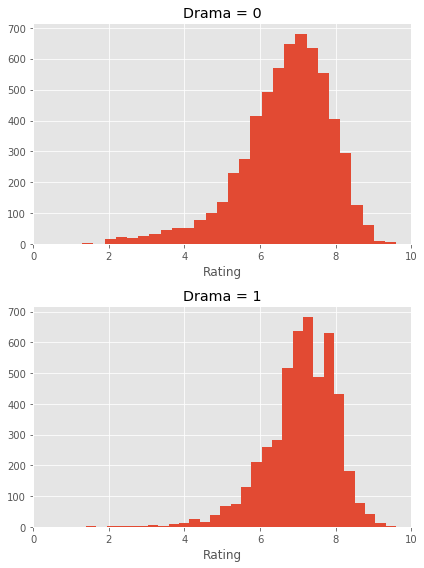

In [18]:
def plot_binary_hists(df, feature):    
    fig = plt.figure(figsize=(6, 8))

    plt.subplot(2, 1, 1)
    plt.title(f"{feature} = 0")
    plt.xlabel('Rating')
    plt.xlim(0, 10)
    df[df[feature]==0]['imdbRating'].hist(bins=30)

    plt.subplot(2, 1, 2)
    plt.title(f"{feature} = 1")
    plt.xlabel('Rating')
    plt.xlim(0, 10)
    df[df[feature]==1]['imdbRating'].hist(bins=30)

    fig.tight_layout()

plot_binary_hists(imdb_train, 'Drama')
plt.show()

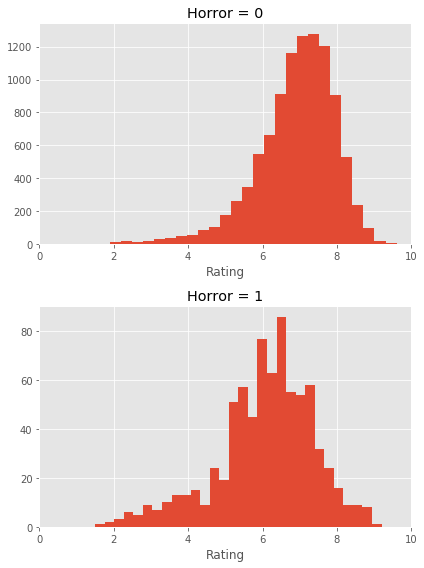

In [19]:
plot_binary_hists(imdb_train, 'Horror')
plt.show()

In [20]:
print(imdb_train['type'].unique())

['video.movie' 'game' 'video.tv' 'video.episode']


In [21]:
# analyze each media type separately
imdb_movies = imdb_train[imdb_train['type']=='video.movie']
imdb_games = imdb_train[imdb_train['type']=='game']
imdb_episodes = imdb_train[imdb_train['type']=='video.episode']
imdb_tv_shows = imdb_train[imdb_train['type']=='video.tv']

In [22]:
# find featuers that correlate with the IMDb rating for movies only
imdb_movies.corr()['imdbRating'].sort_values(ascending=False)

imdbRating           1.000000
winsPerNomination    0.314331
nrOfWins             0.287974
totalNominations     0.278329
Drama                0.248357
nrOfNominations      0.243225
ratingCount          0.213380
duration             0.185504
nrOfUserReviews      0.143836
War                  0.103556
History              0.100450
Biography            0.096981
nrOfNewsArticles     0.096217
nrOfPhotos           0.088006
Documentary          0.084618
FilmNoir             0.069339
Romance              0.048278
Animation            0.046987
Music                0.046450
TalkShow             0.025024
Crime                0.023038
Musical              0.019705
GameShow             0.005981
Western              0.004182
News                 0.003865
RealityTV            0.000126
Sport               -0.001548
Short               -0.001918
Mystery             -0.002329
nrOfGenre           -0.012287
titleWordCount      -0.018844
Adult               -0.024189
Thriller            -0.048815
Adventure 

In [24]:
# find featuers that correlate with the IMDb rating for games only
imdb_games.corr()['imdbRating'].sort_values(ascending=False)

imdbRating           1.000000
nrOfUserReviews      0.492883
ratingCount          0.490318
totalNominations     0.364227
nrOfWins             0.342938
nrOfNominations      0.327197
winsPerNomination    0.296019
year                 0.293908
nrOfGenre            0.240210
nrOfPhotos           0.209868
Adventure            0.207499
Comedy               0.180147
History              0.169392
nrOfNewsArticles     0.152663
Drama                0.122095
Fantasy              0.115308
Mystery              0.091536
Horror               0.081203
titleWordCount       0.080934
Animation            0.017469
Sport               -0.001266
Western             -0.001266
Family              -0.001684
Action              -0.004424
War                 -0.026456
Crime               -0.047587
reviewsPerRating    -0.091726
Romance             -0.113940
SciFi               -0.125571
Thriller            -0.181427
duration                  NaN
Adult                     NaN
Biography                 NaN
Documentar

In [25]:
imdb_games.head()

,fn,tid,title,wordsInTitle,url,imdbRating,ratingCount,duration,year,type,...,Short,Sport,TalkShow,Thriller,War,Western,totalNominations,winsPerNomination,reviewsPerRating,titleWordCount
index,,,,,,,,,,,,,,,,,,,,,
7982,titles04/index.html.11856,tt1319708,Deus Ex: Human Revolution (Video Game 2011),deus ex human revolution video game,http://www.imdb.com/title/tt1319708/,8.7,2663.0,NaN,2011.0,game,...,0,0,0,0,0,0,0,0.0,0.004506,6.0
5659,titles03/index.html.5805,tt1525855,La abadía del crimen (Video Game 1987),la abad a del crimen video game,http://www.imdb.com/title/tt1525855/,6.8,6.0,NaN,1987.0,game,...,0,0,0,0,0,0,0,0.0,0.000000,7.0
4332,titles03/index.html.4270,tt0450955,50 Cent: Bulletproof (Video Game 2005),cent bulletproof video game,http://www.imdb.com/title/tt0450955/,3.4,389.0,NaN,2005.0,game,...,0,0,0,1,0,0,0,0.0,0.017995,4.0
3360,titles03/index.html.3029,tt0185037,The Legend of Zelda 2: Rinku no bôken (Video G...,the legend of zelda rinku no b ken video game,http://www.imdb.com/title/tt0185037/,7.3,519.0,NaN,1987.0,game,...,0,0,0,0,0,0,0,0.0,0.028902,10.0
14174,titles04/index.html.8951,tt0421136,Leisure Suit Larry: Magna Cum Laude (Video Gam...,leisure suit larry magna cum laude video game,http://www.imdb.com/title/tt0421136/,6.5,150.0,NaN,2004.0,game,...,0,0,0,0,0,0,0,0.0,0.006667,8.0


In [26]:
# duration should be filled with 0 for games so that models learn to ignore it
imdb_train.loc[imdb_train['type']=='game', 'duration'].fillna(0, inplace=True)

In [27]:
# find featuers that correlate with the IMDb rating for TV shows only
imdb_tv_shows.corr()['imdbRating'].sort_values(ascending=False)

imdbRating           1.000000
ratingCount          0.311762
nrOfUserReviews      0.293095
nrOfGenre            0.228716
Drama                0.176863
Crime                0.146109
Mystery              0.133434
Comedy               0.125068
nrOfPhotos           0.115791
History              0.106833
winsPerNomination    0.098696
Action               0.097240
Thriller             0.090489
Animation            0.085817
War                  0.073329
Adventure            0.066001
nrOfWins             0.057945
Western              0.056478
Biography            0.056026
totalNominations     0.052442
Fantasy              0.052168
nrOfNominations      0.048863
SciFi                0.040451
nrOfNewsArticles     0.037501
duration             0.027023
Horror               0.025253
Sport                0.014734
Musical              0.004358
year                 0.001693
Short                0.001345
Documentary         -0.000930
titleWordCount      -0.041163
Romance             -0.044357
Music     

In [31]:
# find featuers that correlate with the IMDb rating for episodes only
imdb_episodes.corr()['imdbRating'].sort_values(ascending=False)

imdbRating           1.000000
Drama                0.222867
ratingCount          0.217766
nrOfPhotos           0.178619
Mystery              0.166849
SciFi                0.133270
nrOfUserReviews      0.124227
Horror               0.121992
Fantasy              0.095144
nrOfGenre            0.088180
Crime                0.087010
Action               0.053573
Sport                0.039736
History              0.037880
Adventure            0.033893
duration             0.032605
nrOfNominations      0.029857
totalNominations     0.028363
nrOfNewsArticles     0.020617
reviewsPerRating     0.020225
nrOfWins             0.017560
winsPerNomination    0.016646
Biography            0.015000
Comedy               0.004310
Western              0.001569
Romance              0.001230
Thriller            -0.001016
War                 -0.010081
Short               -0.026395
year                -0.027166
Family              -0.029292
Musical             -0.038319
GameShow            -0.039009
Documentar

Notes about the data so far:
- There are 4 types of media: movies, TV shows, TV episodes and games
- For movies:
  - Rating positively correlates with the ratio of wins to total nominations
  - Rating positively correlates with the duration, it seems longer movies are rated higher
  - Rating negatively correlates with the year, it seems old movies are rated higher than new movies
  - Rating negatively correlates with the ratio of user reviews to user ratings, people seem to review movies they dislike more than movies they like
  - Drama movies tend to get higher ratings
  - Horror movies tend to get lower ratings
- For games:
  - Duration should be set to 0 for games so that models learn to ignore it
  - Rating positively correlates with the ratio of wins to total nominations
  - Rating positively correlates with the year, it seems new games are rated higher than old games
  - Adventure games tend to get higher ratings
  - Thriller games tend to get lower ratings
- For TV shows:
  - Duration does not seem to affect rating
  - Year of release does not seem to affect rating
  - Drama shows tend to have higher ratings
  - Reality TV shows tend to have lower ratings
- For TV episodes:
  - Duration does not seem to affect rating
  - Year of release does not seem to affect rating
  - Episodes with the Drama genre tend to have higher ratings
  - Episodes with the News genre tend to have lower ratings
- There is a weak correlation between rating and title word count